In [1]:
import spatialcell as cs
import numpy as np
import matplotlib.pyplot as plt

In [2]:
so = cs.prepare_dataframe_image( '../square_002um/spatial/tissue_positions.parquet','../Visium_HD_Mouse_Brain_tissue_image.tif' )

In [4]:
i_max = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:].shape[0]
j_max = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:].shape[1]
num = 0
loop = 4700
segmentation_results = {}
gap = 80

In [5]:
# Import the StarDist 2D segmentation models.
# Import the recommended normalization technique for stardist.
from csbdeep.utils import normalize
from stardist.models import StarDist2D

import numpy as np

import matplotlib.pyplot as plt

# Import squidpy and additional packages needed for this tutorial.
import squidpy as sq

2024-06-03 04:45:06.728709: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-06-03 04:45:06.770791: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-06-03 04:45:06.770814: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-06-03 04:45:06.771698: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-06-03 04:45:06.777235: I tensorflow/core/platform/cpu_feature_guar

In [6]:
StarDist2D.from_pretrained("2D_versatile_he")

def stardist_2D_versatile_he(img, nms_thresh=None, prob_thresh=None):
    # axis_norm = (0,1)   # normalize channels independently
    axis_norm = (0, 1, 2)  # normalize channels jointly
    # Make sure to normalize the input image beforehand or supply a normalizer to the prediction function.
    # this is the default normalizer noted in StarDist examples.
    img = normalize(img, 1, 99.8, axis=axis_norm)
    model = StarDist2D.from_pretrained("2D_versatile_he")
    labels, _ = model.predict_instances(
        img, nms_thresh=nms_thresh, prob_thresh=prob_thresh
    )
    return labels

Found model '2D_versatile_he' for 'StarDist2D'.


2024-06-03 04:45:14.103842: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1929] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 22258 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3090, pci bus id: 0000:65:00.0, compute capability: 8.6


Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


In [15]:
import copy

def clean(array_im):
    target_colors = np.array([[155, 60, 126],
                              [128,24,101],
                              [190,118,172],
                              [220,95,176],
                              [139,42,110],
                              [132,39,102],
                              [136,44,108],
                              [125,53,110],
                              [109,39,91],
                              [178,90,144],
                              [149,67,122],
                              [191,70,159],
                              [186,69,150 ],
                              [176,40,132 ]]
                            )

    new_color = [250,139,209]
    threshold = 20
    for target_color in target_colors:
        
        distances = np.sqrt(((array_im - target_color)**2).sum(axis=-1))
        array_im[distances < threshold] = new_color
        
    return array_im

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


2024-06-03 04:45:27.210678: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8904
2024-06-03 04:45:27.431966: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-06-03 04:45:30.795416: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory


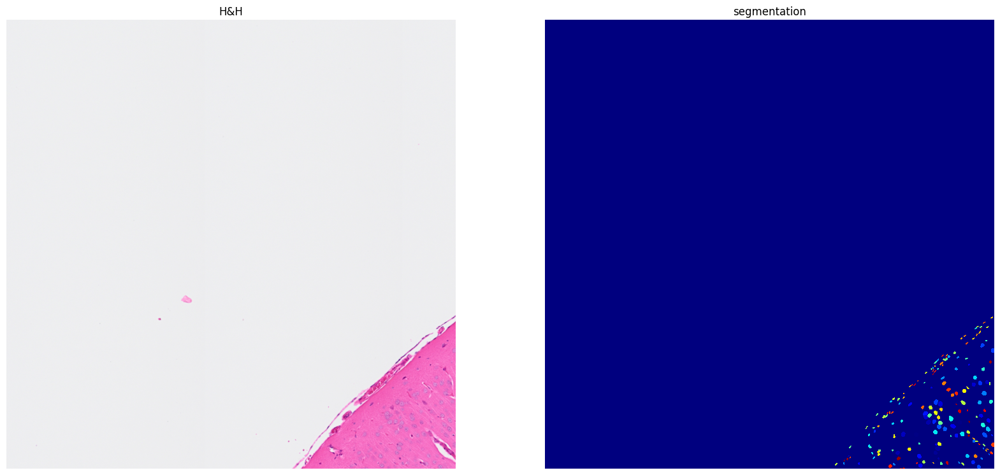

In [7]:
i= loop*0
j = loop*0
a_t = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:][max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.3,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] =  np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


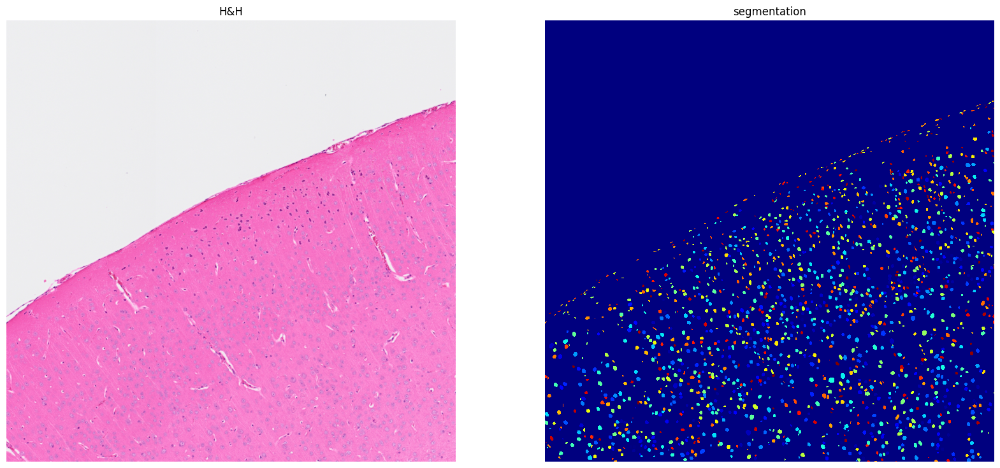

In [16]:
i= loop*0
j = loop*1
a_t = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:][max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a_t = clean(a_t)
a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.35,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


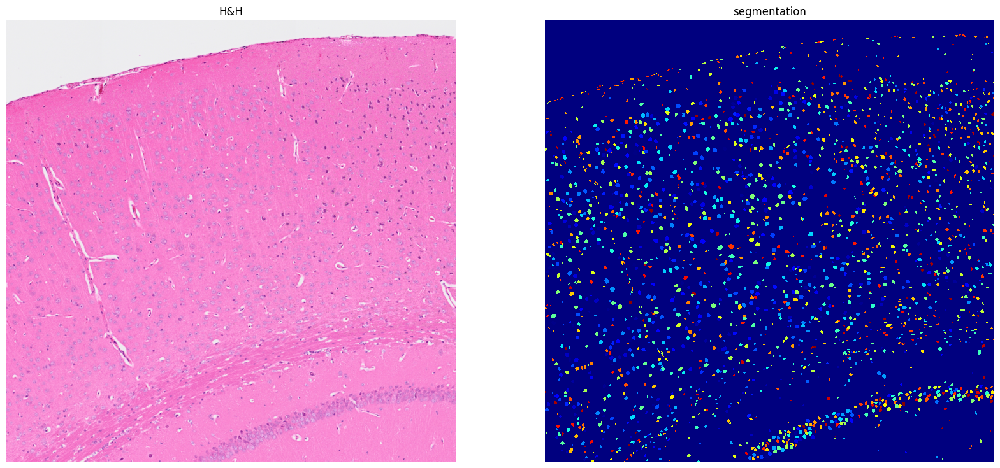

In [17]:
i= loop*0
j = loop*2
a_t = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:][max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a_t = clean(a_t)
a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.4,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


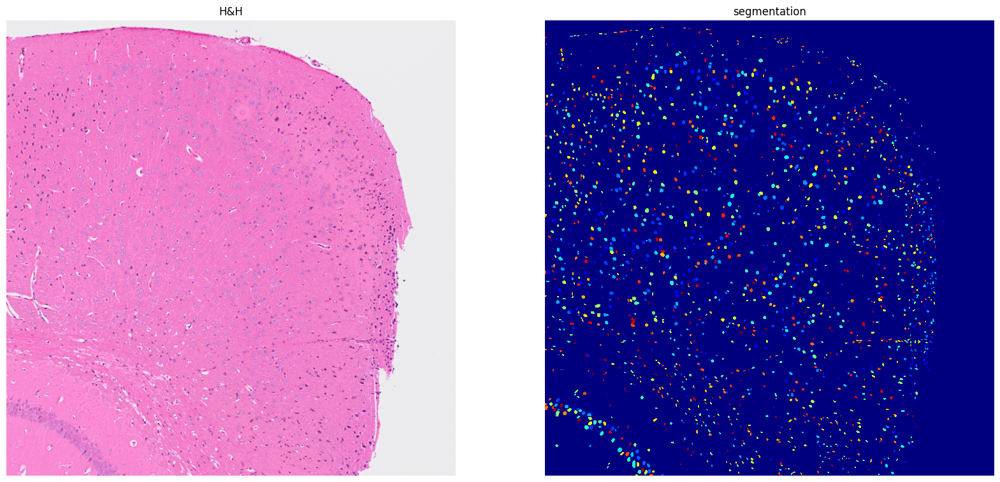

In [18]:
i= loop*0
j = loop*3
a_t = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:][max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a_t = clean(a_t)
a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.4,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


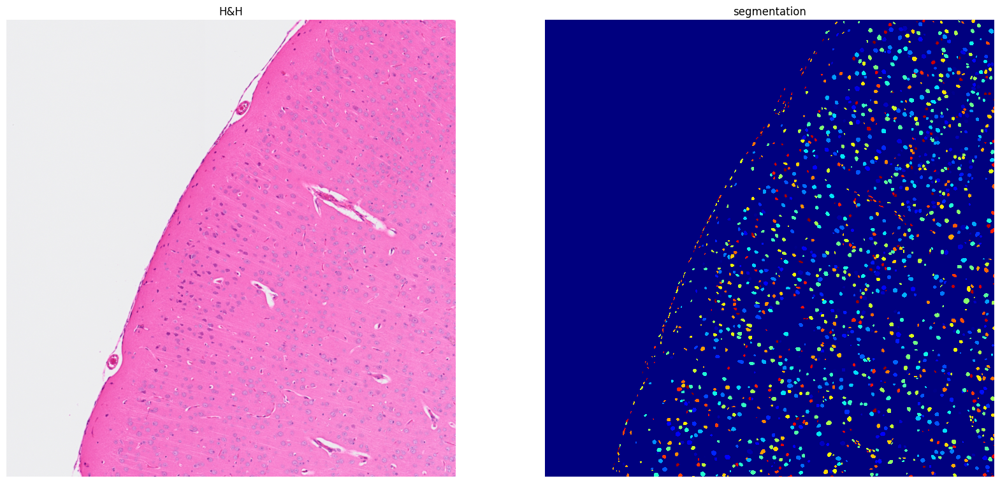

In [21]:
i= loop*1
j = loop*0
a_t = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:][max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.3,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


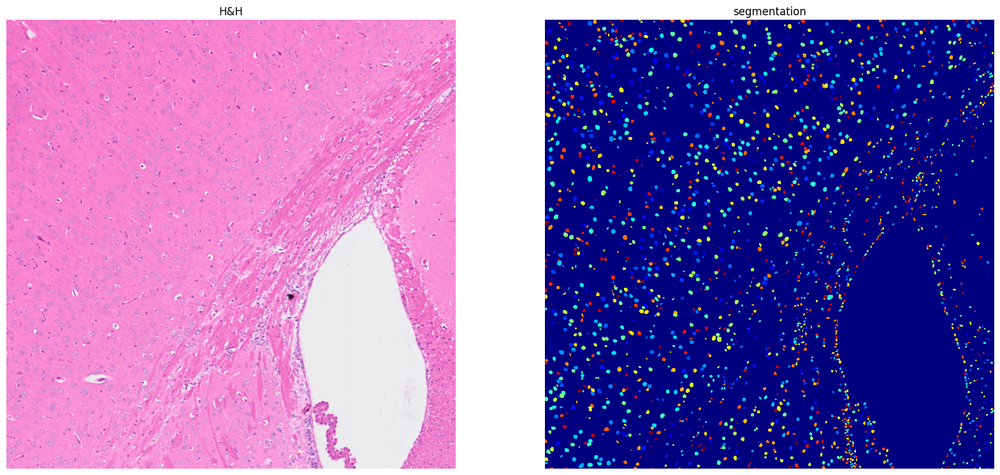

In [22]:
i= loop*1
j = loop*1
a_t = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:][max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.3,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


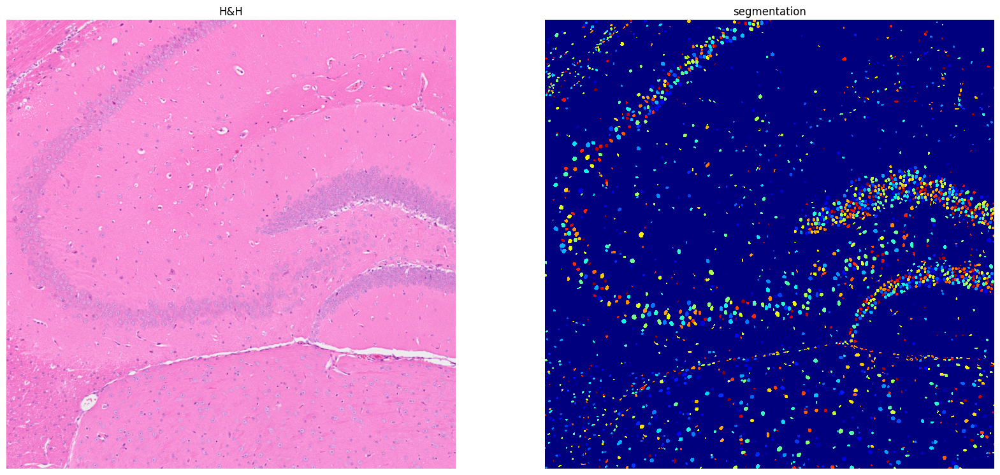

In [27]:
i= loop*1
j = loop*2
a_t = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:][max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.3,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


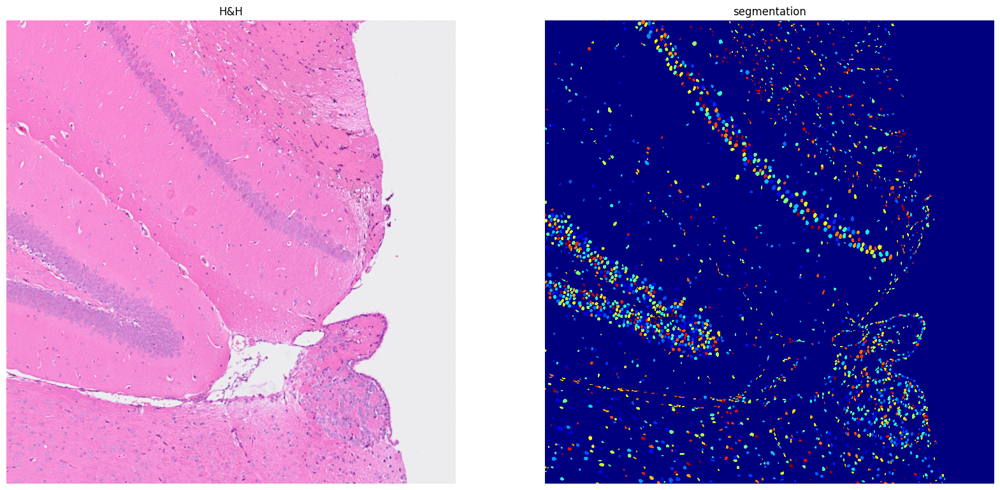

In [25]:
i= loop*1
j = loop*3
a_t = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:][max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a_t = clean(a_t)
a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.35,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


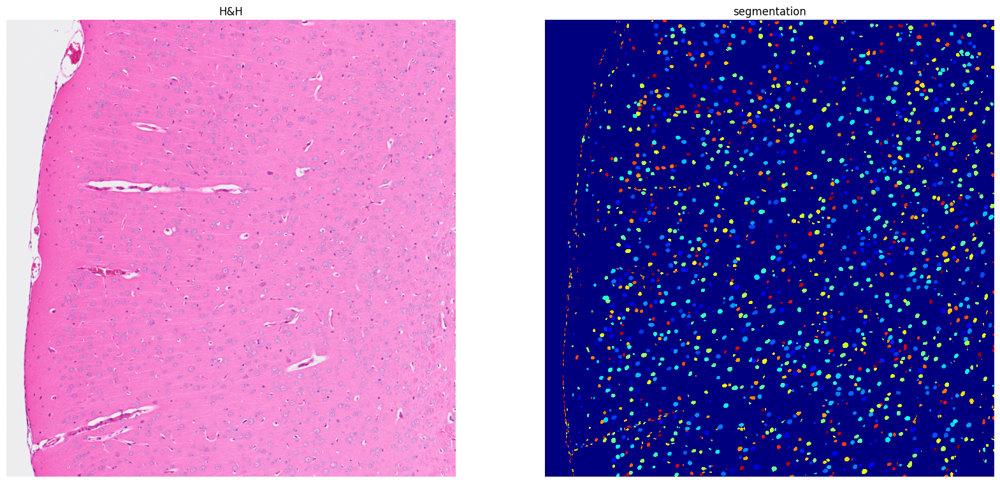

In [28]:
i= loop*2
j = loop*0
a_t = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:][max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.3,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


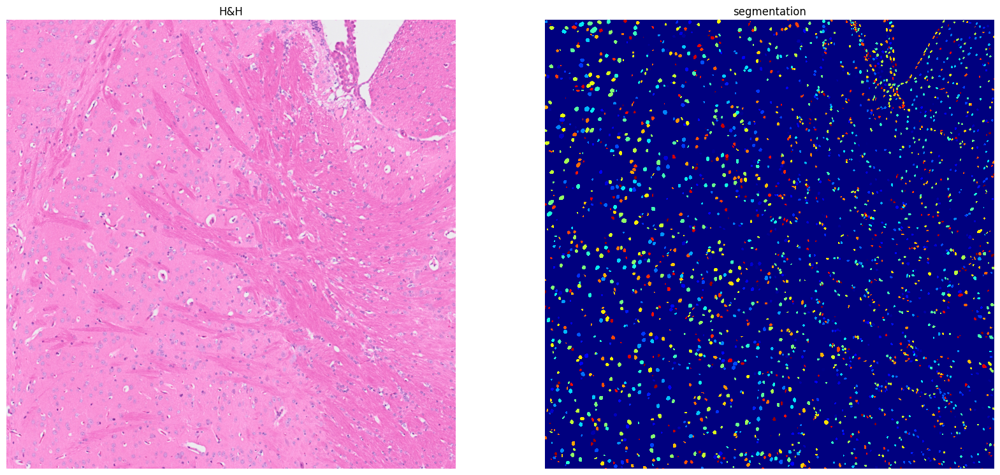

In [29]:
i= loop*2
j = loop*1
a_t = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:][max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.3,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


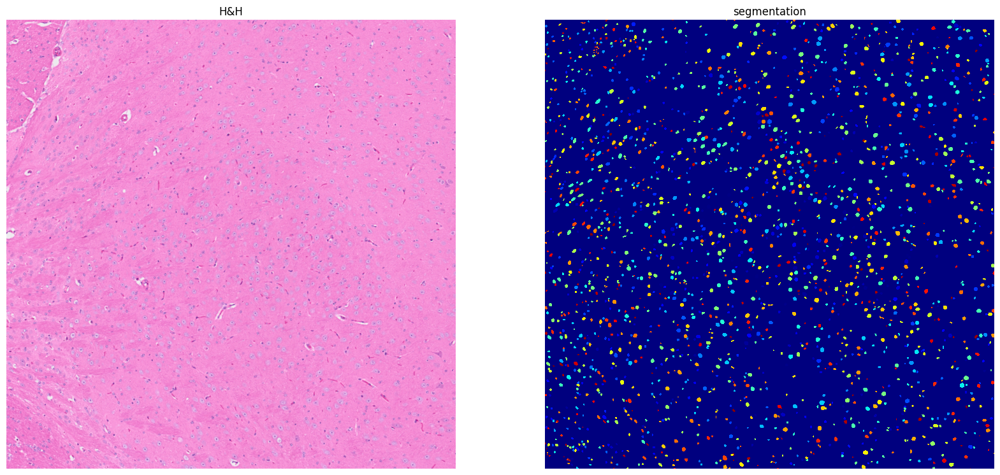

In [30]:
i= loop*2
j = loop*2
a_t = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:][max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.3,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


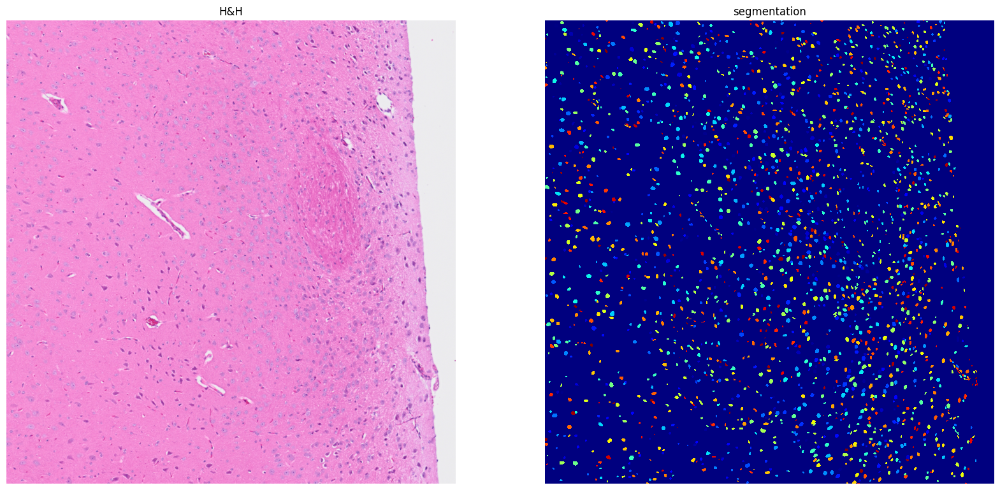

In [31]:
i= loop*2
j = loop*3
a_t = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:][max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.3,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


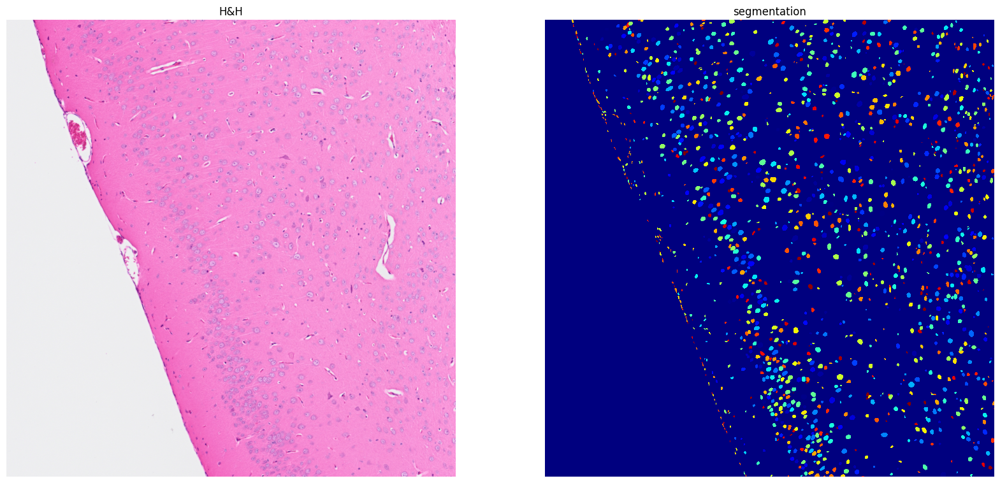

In [33]:
i= loop*3
j = loop*0
a_t = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:][max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.3,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


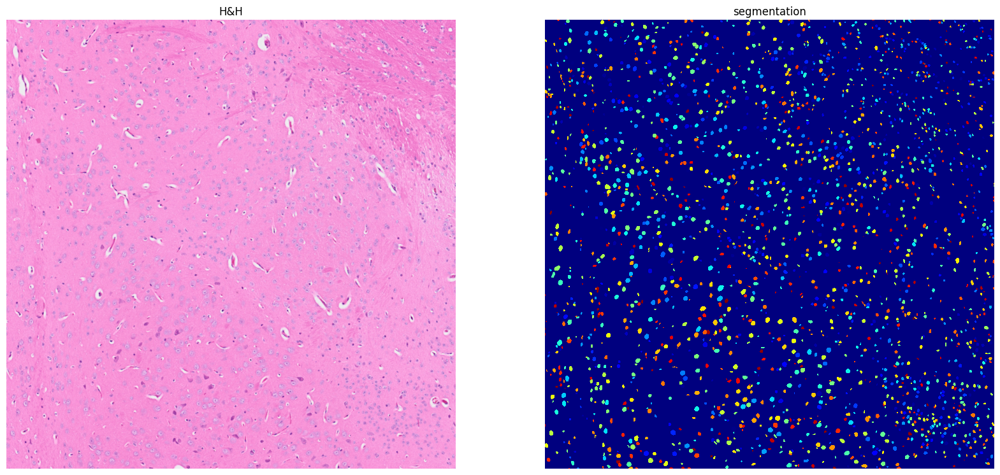

In [34]:
i= loop*3
j = loop*1
a_t = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:][max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.3,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")


segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


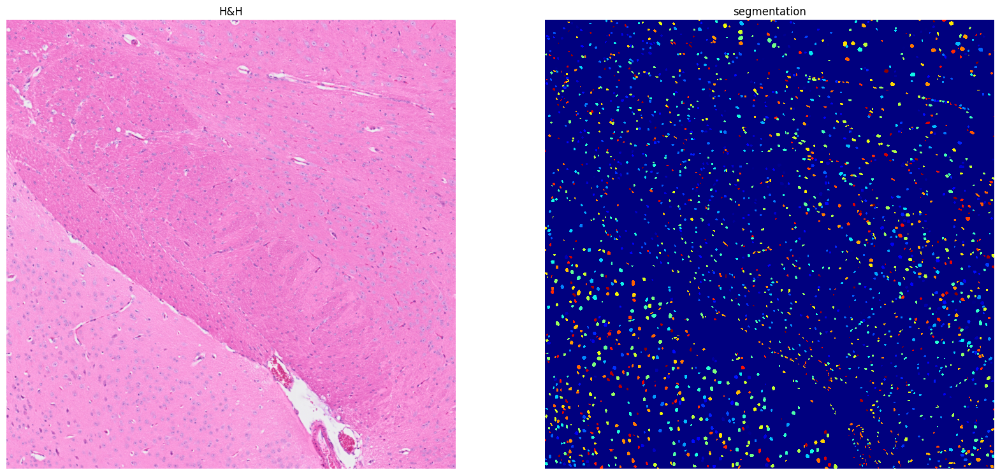

In [35]:
i= loop*3
j = loop*2
a_t = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:][max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.3,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")


segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


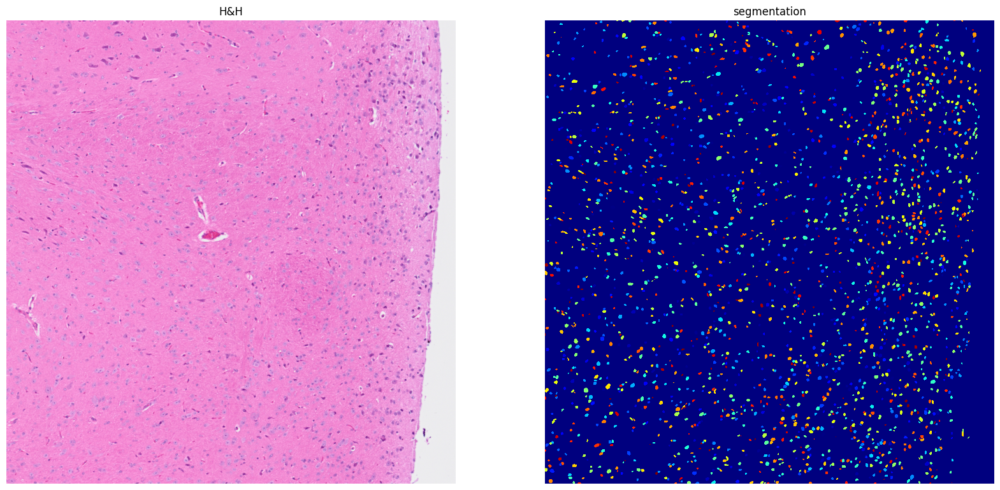

In [36]:
i= loop*3
j = loop*3
a_t = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:][max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.3,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")


segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


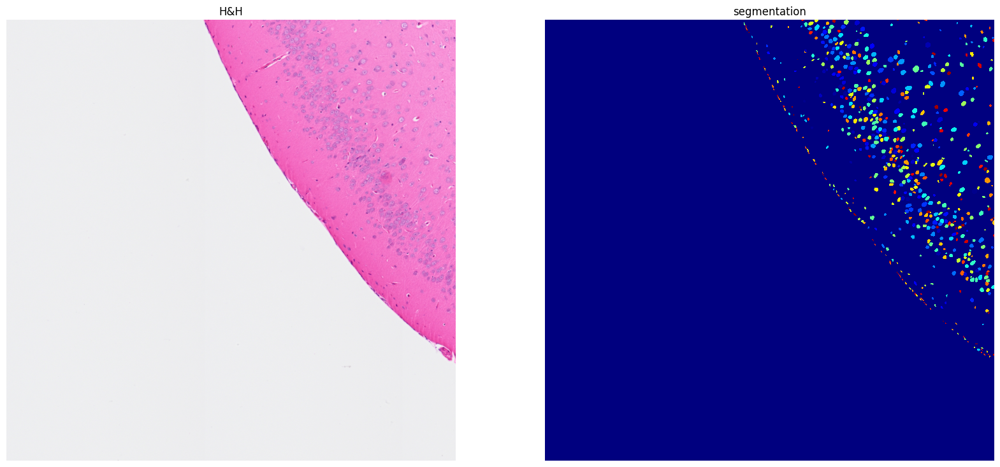

In [37]:
i= loop*4
j = loop*0
a_t = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:][max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.3,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")


segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


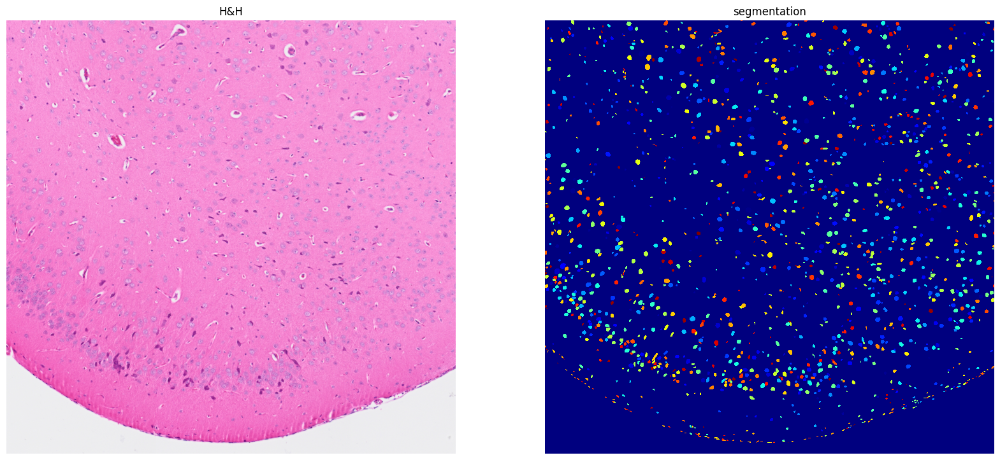

In [38]:
i= loop*4
j = loop*1
a_t = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:][max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.3,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")


segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


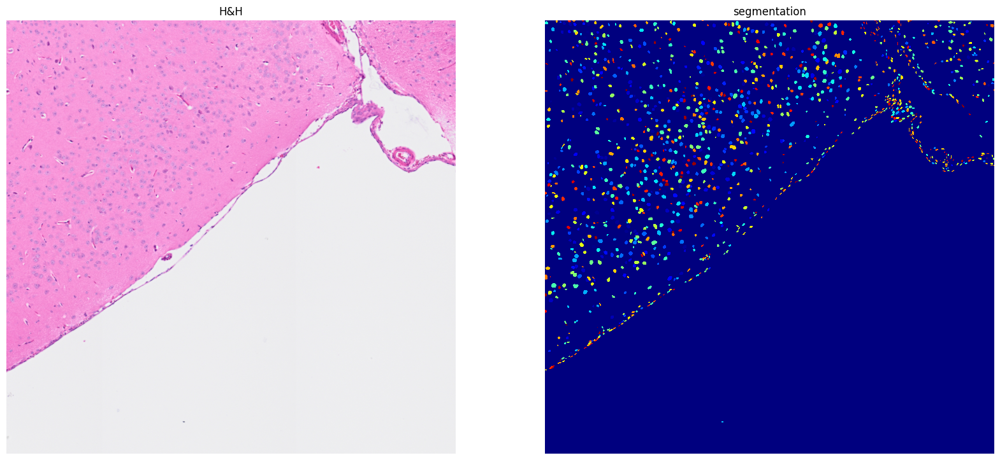

In [39]:
i= loop*4
j = loop*2
a_t = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:][max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.3,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")


segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


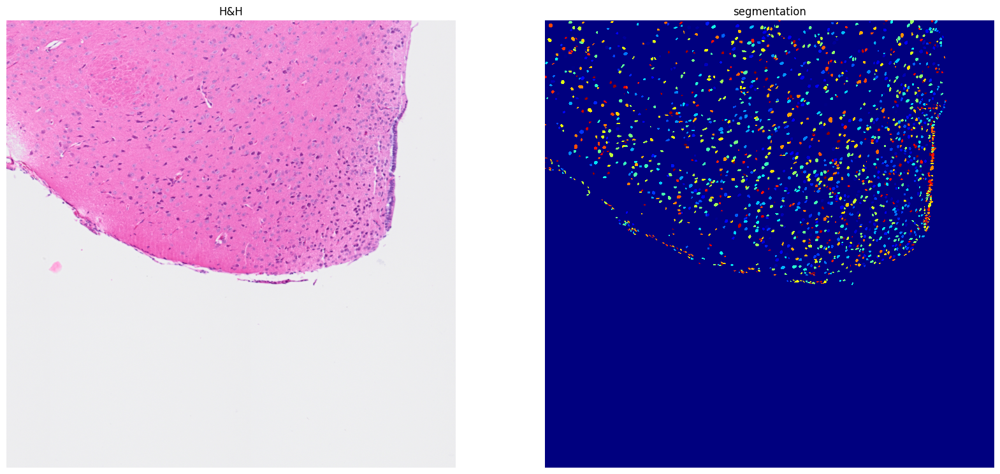

In [40]:
i= loop*4
j = loop*3
a_t = so.image[ so.row_left: so.row_right, so.col_up: so.col_down,:][max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.3,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")


segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

In [41]:
so.add_segmentation(segmentation_results , i_max, j_max, loop, gap)

In [42]:
so.generate_cell_spots_information()

Generating cells information.


100%|██████████| 23340/23340 [01:02<00:00, 375.69it/s]


Generating spots information.


100%|██████████| 23340/23340 [02:54<00:00, 133.46it/s]


The large number of nucleis per spot is 4.
Filtering cells
Creating NN network


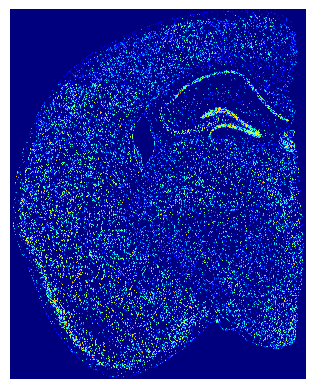

In [43]:
plt.imshow(np.log(so.segmentation_final+1),cmap='jet',)
plt.axis('off')
plt.show()

In [ ]:
import pickle
with open("results_example/so.pkl", 'wb') as f:
    pickle.dump(so, f)